In [ ]:
!pip install basemap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 936.0/936.0 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.5/30.5 MB 18.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 2.5 MB/s eta 0:00:00
  Attempting uninstall: packaging
    Found existing installation: packaging 24.1
    Uninstalling packaging-24.1:
      Successfully uninstalled packaging-24.1


In [ ]:
import matplotlib.pyplot as plt
plt.style.use('bmh')
import pandas as pd
import seaborn as sns
import numpy as np
import folium as fl
from folium.plugins import MiniMap
from folium.plugins import FloatImage
from geopy.distance import geodesic
from geopy.geocoders import Nominatim
app = Nominatim(user_agent="tycgis")
from datetime import datetime
from geopy.distance import distance

# Aqui cargamos Basemap
from mpl_toolkits.basemap import Basemap
from matplotlib.patches import Polygon
from matplotlib.collections import PatchCollection

from folium import plugins

In [ ]:
df_sensores = pd.read_excel('/content/drive/MyDrive/Proyectos/PIT/2024-2025/base-datos-gps-2022.xlsx')

In [ ]:
df_sensores.head(5)

,Date,Time,Latitude,Longitude,Altitude,Speed,Course,Type,Distance,Essential,lat,long,raza,potrero,id-vaca,estacion,año
0,2022-06-15,10:04:38,-30009178,-65857872,320.83,0.0,326,-2,0.00,1,-30.009178,-65.857872,AA,4,B960,invierno,2022
1,2022-06-15,10:15:00,-30009254,-65857803,307.93,0.0,145,0,10.75,1,-30.009254,-65.857803,AA,4,B960,invierno,2022
2,2022-06-15,10:25:25,-30009169,-65857819,320.45,0.0,21,0,9.58,1,-30.009169,-65.857819,AA,4,B960,invierno,2022
3,2022-06-15,10:35:50,-30009192,-65857887,308.43,0.0,79,0,7.03,1,-30.009192,-65.857887,AA,4,B960,invierno,2022
4,2022-06-15,10:46:18,-30009226,-65857903,297.46,0.0,20,0,4.08,1,-30.009226,-65.857903,AA,4,B960,invierno,2022


In [ ]:
df_sensores.dtypes

,0
date,datetime64[ns]
time,object
latitude,int64
longitude,int64
altitude,float64
speed,float64
course,int64
type,int64
distance,float64
essential,object


In [ ]:
df_sensores.shape

(10047, 17)

In [ ]:
df_sensores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10047 entries, 0 to 10046
Data columns (total 17 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   Date        10047 non-null  datetime64[ns]
 1    Time       10047 non-null  object        
 2    Latitude   10047 non-null  int64         
 3    Longitude  10047 non-null  int64         
 4    Altitude   10047 non-null  float64       
 5    Speed      10047 non-null  float64       
 6    Course     10047 non-null  int64         
 7    Type       10047 non-null  int64         
 8    Distance   10047 non-null  float64       
 9    Essential  10047 non-null  object        
 10  lat         10047 non-null  float64       
 11  long        10047 non-null  float64       
 12  raza        10047 non-null  object        
 13  potrero     10047 non-null  int64         
 14  id-vaca     10047 non-null  object        
 15  estacion    10047 non-null  object        
 16  año         10047 non-

In [ ]:
print(df_sensores.columns)

Index(['Date', ' Time', ' Latitude', ' Longitude', ' Altitude', ' Speed',
       ' Course', ' Type', ' Distance', ' Essential', 'lat', 'long', 'raza',
       'potrero', 'id-vaca', 'estacion', 'año'],
      dtype='object')


In [ ]:
# Estandarizar los nombres de las columnas
df_sensores.columns = df_sensores.columns.str.strip()  # Eliminar espacios en blanco
df_sensores.columns = df_sensores.columns.str.lower()  # Convertir a minúsculas

In [ ]:
df_sensores= df_sensores.sort_values(by=['date', 'time'])

In [ ]:
df_sensores.distance.sum()

1778248.1799999997

In [ ]:
df_sensores['long'].min()

-65.889816

In [ ]:
df_sensores['long'].max()

-65.535172

In [ ]:
df_sensores['Date'].nunique()

21

In [ ]:
df_sensores.describe()

,Date,lat,long
count,10047,10047.000000,10047.000000
mean,2022-06-21 20:34:28.199462400,-29.814537,-65.848878
min,2022-06-15 00:00:00,-30.031855,-65.889816
25%,2022-06-18 00:00:00,-30.021266,-65.880535
50%,2022-06-21 00:00:00,-30.001513,-65.860672
75%,2022-06-25 00:00:00,-29.992331,-65.850727
max,2022-07-05 00:00:00,-28.454609,-65.535172
std,NaN,0.505592,0.054165


In [ ]:
df_sensores.raza.unique()

array(['CR', 'AA'], dtype=object)

In [ ]:
latitud=df_sensores.lat.mean()
longitud=df_sensores.long.mean()

In [ ]:
sns.set(style="white", color_codes=True)

%matplotlib inline

## **Crear dataframe con ubicaciones**

In [ ]:
ubicaciones = df_sensores[['date','time', 'lat', 'long', 'raza']].sort_values(by=['date', 'time'])
ubicaciones

,date,time,lat,long,raza
6122,2022-06-15,09:11:37,-30.009121,-65.857834,CR
5224,2022-06-15,09:24:01,-30.009054,-65.857780,CR
6123,2022-06-15,09:28:20,-30.009111,-65.857941,CR
5225,2022-06-15,09:43:30,-30.008760,-65.858109,CR
6124,2022-06-15,09:49:37,-30.009176,-65.858139,CR
...,...,...,...,...,...
5222,2022-07-05,13:36:19,-28.496145,-65.667679,AA
8281,2022-07-05,13:37:40,-28.496439,-65.667870,CR
5223,2022-07-05,13:48:33,-28.496334,-65.667419,AA
3109,2022-07-05,13:56:44,-28.496370,-65.667839,AA


## **Calcular distancia recorrida diaria**

In [ ]:
distancia = 0
distancia_recorrida = 0
distancias = []

indice=len(df_sensores)
for i in range(1, indice):
      # Obtener las coordenadas de los dos puntos
      punto1 = (df_sensores.iloc[i-1]['lat'], df_sensores.iloc[i-1]['long'])
      punto2 = (df_sensores.iloc[i]['lat'], df_sensores.iloc[i]['long'])
      # Calcular la distancia entre los dos puntos
      distancia = round(distance(punto1, punto2).km,2)
      distancias.append(distancia)
      distancia_recorrida += distancia


print(f'Distancia total recorrida: {distancia_recorrida} km')

# Añadir la última distancia como 0 ya que no hay un punto siguiente
#distancias.append(0)
distancias.insert(0, 0)

# Añadir la columna de distancias al DataFrame
ubicaciones['distancia_km'] = distancias

Distancia total recorrida: 23227.349999999587 km


In [ ]:
# Inicializar una lista para almacenar los resultados
resultados = []

# Obtener las razas únicas
razas_unicas = df_sensores['raza'].unique()

# Iterar por cada raza
for raza in razas_unicas:
    # Filtrar las vacas de la raza específica
    df_raza = df_sensores[df_sensores['raza'] == raza]

    # Ordenar por fecha para asegurar que las distancias se calculen correctamente en secuencia temporal
    df_raza = df_raza.sort_values(by=['date'])

    # Iterar por las filas de la raza específica
    for i in range(1, len(df_raza)):
        # Obtener las coordenadas de los dos puntos
        punto1 = (df_raza.iloc[i - 1]['lat'], df_raza.iloc[i - 1]['long'])
        punto2 = (df_raza.iloc[i]['lat'], df_raza.iloc[i]['long'])

        # Calcular la distancia entre los dos puntos
        distancia = round(distance(punto1, punto2).km, 2)

        # Agregar la nueva fila a la lista de resultados
        resultados.append({'date': df_raza.iloc[i]['date'], 'raza': raza, 'distancia_km': distancia})

# Convertir la lista de resultados en un DataFrame
df_distancias_diarias = pd.DataFrame(resultados)

# Mostrar el DataFrame final
print(df_distancias_diarias)


            date raza  distancia_km
0     2022-06-15   CR          2.93
1     2022-06-15   CR          0.04
2     2022-06-15   CR          4.46
3     2022-06-15   CR          4.50
4     2022-06-15   CR          4.58
...          ...  ...           ...
10040 2022-07-05   AA          0.11
10041 2022-07-05   AA          0.10
10042 2022-07-05   AA          0.10
10043 2022-07-05   AA         11.02
10044 2022-07-05   AA          0.05

[10045 rows x 3 columns]


In [ ]:
df_distancias_diarias.distancia_km.sum()

19363.85

In [ ]:
df_distancias_promedio=df_distancias_diarias.groupby(['date','raza'])['distancia_km'].mean().reset_index()

In [ ]:
df_distancias_promedio

,date,raza,distancia_km
0,2022-06-15,AA,0.426635
1,2022-06-15,CR,1.765853
2,2022-06-16,AA,0.928217
3,2022-06-16,CR,2.400411
4,2022-06-17,AA,1.166612
5,2022-06-17,CR,1.410320
6,2022-06-18,AA,1.654766
7,2022-06-18,CR,1.393626
8,2022-06-19,AA,1.782712
9,2022-06-19,CR,1.447216


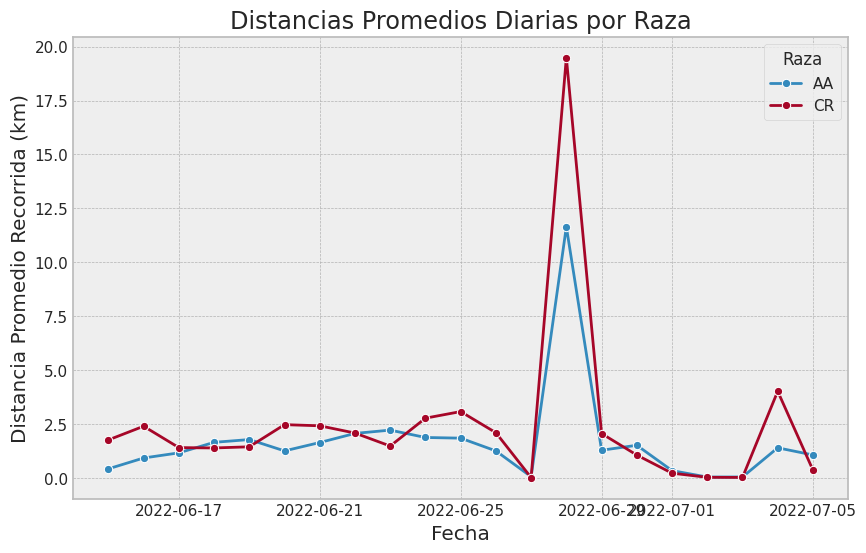

In [ ]:
# Configurar el estilo del gráfico
plt.style.use('bmh')

# Crear un gráfico de líneas para mostrar las distancias diarias por raza
plt.figure(figsize=(10, 6))
sns.lineplot(data=df_distancias_promedio, x='date', y='distancia_km', hue='raza', marker='o')

# Agregar título y etiquetas
plt.title('Distancias Promedios Diarias por Raza')
plt.xlabel('Fecha')
plt.ylabel('Distancia Promedio Recorrida (km)')

# Mostrar la leyenda
plt.legend(title='Raza', loc='upper right')

# Mostrar el gráfico
plt.show()

In [ ]:
ubicaciones = df_sensores[['lat', 'long']]

In [ ]:
mapa_base = fl.Map([latitud, longitud], zoom_start=8, tiles="CartoDB positron")
#mapa_base.save("Mapa_base.html")
minimap = plugins.MiniMap()

# plot heatmap


mapa_base.add_child(plugins.HeatMap(ubicaciones, radius=15))
mapa_base.add_child(minimap)
mapa_base

In [ ]:
url='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}'
attr= 'Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community'
map = fl.Map(location=[latitud, longitud], zoom_start=12, control_scale=True)
fl.TileLayer(tiles=url, attr=attr).add_to(map)
plugins.MarkerCluster(ubicaciones).add_to(map)
map.add_child(plugins.HeatMap(ubicaciones, radius=15))

# Definir los colores para cada raza
color_dict  = {'AA': 'blue', 'CR': 'red'}  # Asignar color azul a 'AA' y rojo a 'CR'

for i in range(0, len(df_sensores)):
  color = color_dict.get(df_sensores.loc[i,'raza'], 'green')  # Si la raza no está en el diccionario, asignar color verde por defecto
  popup= '<b>Latitud:</b>  ' + str(df_sensores.loc[i,'lat']) + '</br><b>Longitud:</b> ' + str(df_sensores.loc[i,'long']) + '</br><b>Raza: </b>' + str(df_sensores.loc[i,'raza']) + '</br><b>ID: </b>' + str(df_sensores.loc[i,'id-vaca'])
  fl.CircleMarker(location=[df_sensores.loc[i,'lat'], df_sensores.loc[i,'long']],
                  radius=2,
                  color=color,
                  popup=fl.Popup(popup,max_width=200)).add_to(map)
minimap = plugins.MiniMap(toggle_display=True)
map.add_child(minimap)
map.save("Monitoreo animal.html")
map

In [ ]:
# with matplotlib
figure = plt.figure(figsize=(10,8))
plt.scatter(df_sensores.long, df_sensores.lat, s=10, c='lightblue')
plt.show()